#  FCN8 cho bài toán pixel-level segmentation với bộ dữ liệu cityscapes:
- Link tải bộ Cityscapes: https://www.cityscapes-dataset.com/downloads/

- Mô tả bộ dữ liệu: https://www.cityscapes-dataset.com/dataset-overview

---



In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
cd drive/'My Drive'/'Colab Notebooks'/L15

/content/drive/My Drive/Colab Notebooks/L15


# 1.Download data
Download tập ảnh được gán nhãn đúng (fine ground truth annotations) (file zip 11GB) và tập nhãn tương ứng (file zip 241MB).   
Do kích thước dataset tương đối lớn, ta tải trực tiếp dữ liệu vào disk trên google colab sử dụng wget. Chú ý, để tải được bộ dữ liệu, cần tài khoản và đăng nhập trước khi tải.

Đăng nhập và lấy cookies

In [0]:
!wget --keep-session-cookies --save-cookies=cookies.txt --post-data 'username=****&password=****&submit=Login' https://www.cityscapes-dataset.com/login/

--2019-07-13 16:44:38--  https://www.cityscapes-dataset.com/login/
Resolving www.cityscapes-dataset.com (www.cityscapes-dataset.com)... 139.19.217.8
Connecting to www.cityscapes-dataset.com (www.cityscapes-dataset.com)|139.19.217.8|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://www.cityscapes-dataset.com/downloads/ [following]
--2019-07-13 16:44:41--  https://www.cityscapes-dataset.com/downloads/
Reusing existing connection to www.cityscapes-dataset.com:443.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘index.html’

index.html              [   <=>              ]  40.72K  76.8KB/s    in 0.5s    

2019-07-13 16:44:43 (76.8 KB/s) - ‘index.html’ saved [41695]



Download bộ nhãn (gtFine)

In [0]:
!wget --load-cookies cookies.txt --content-disposition https://www.cityscapes-dataset.com/file-handling/?packageID=1

--2019-07-13 16:44:46--  https://www.cityscapes-dataset.com/file-handling/?packageID=1
Resolving www.cityscapes-dataset.com (www.cityscapes-dataset.com)... 139.19.217.8
Connecting to www.cityscapes-dataset.com (www.cityscapes-dataset.com)|139.19.217.8|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 252567705 (241M) [application/octet-stream]
Saving to: ‘gtFine_trainvaltest.zip’

gtFine_trainvaltest 100%[===================>] 240.87M  10.6MB/s    in 26s     

2019-07-13 16:45:14 (9.18 MB/s) - ‘gtFine_trainvaltest.zip’ saved [252567705/252567705]



Download bộ ảnh (5000 ảnh: 3475  cho training-validation và 1525 cho test)

In [0]:
!wget --load-cookies cookies.txt --content-disposition https://www.cityscapes-dataset.com/file-handling/?packageID=3

--2019-07-13 16:45:17--  https://www.cityscapes-dataset.com/file-handling/?packageID=3
Resolving www.cityscapes-dataset.com (www.cityscapes-dataset.com)... 139.19.217.8
Connecting to www.cityscapes-dataset.com (www.cityscapes-dataset.com)|139.19.217.8|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 11592327197 (11G) [application/octet-stream]
Saving to: ‘leftImg8bit_trainvaltest.zip’

leftImg8bit_trainva 100%[===================>]  10.80G  10.8MB/s    in 17m 23s 

2019-07-13 17:02:41 (10.6 MB/s) - ‘leftImg8bit_trainvaltest.zip’ saved [11592327197/11592327197]



Unzip data

In [0]:
!mkdir cityscapes_dataset

mkdir: cannot create directory ‘cityscapes_dataset’: File exists


In [0]:
!unzip gtFine_trainvaltest.zip -d cityscapes_dataset

Archive:  gtFine_trainvaltest.zip
  inflating: cityscapes_dataset/README  
  inflating: cityscapes_dataset/license.txt  
   creating: cityscapes_dataset/gtFine/train/
   creating: cityscapes_dataset/gtFine/train/jena/
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000020_000019_gtFine_labelIds.png  
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000092_000019_gtFine_polygons.json  
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000061_000019_gtFine_polygons.json  
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000104_000019_gtFine_polygons.json  
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000064_000019_gtFine_labelIds.png  
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000015_000019_gtFine_instanceIds.png  
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000041_000019_gtFine_labelIds.png  
  inflating: cityscapes_dataset/gtFine/train/jena/jena_000097_000019_gtFine_labelIds.png  
  inflating: cityscapes_dataset/gtFine/train/jen

In [0]:
!unzip leftImg8bit_trainvaltest.zip -d cityscapes_dataset

Archive:  leftImg8bit_trainvaltest.zip
replace cityscapes_dataset/README? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
 extracting: cityscapes_dataset/README  
 extracting: cityscapes_dataset/license.txt  
   creating: cityscapes_dataset/leftImg8bit/train/
   creating: cityscapes_dataset/leftImg8bit/train/jena/
 extracting: cityscapes_dataset/leftImg8bit/train/jena/jena_000078_000019_leftImg8bit.png  
 extracting: cityscapes_dataset/leftImg8bit/train/jena/jena_000032_000019_leftImg8bit.png  
 extracting: cityscapes_dataset/leftImg8bit/train/jena/jena_000055_000019_leftImg8bit.png  
 extracting: cityscapes_dataset/leftImg8bit/train/jena/jena_000067_000019_leftImg8bit.png  
 extracting: cityscapes_dataset/leftImg8bit/train/jena/jena_000001_000019_leftImg8bit.png  
 extracting: cityscapes_dataset/leftImg8bit/train/jena/jena_000111_000019_leftImg8bit.png  
 extracting: cityscapes_dataset/leftImg8bit/train/jena/jena_000114_000019_leftImg8bit.png  
 extracting: cityscapes_dataset/leftImg8bit/trai

# 2.Chuẩn bị dữ liệu

In [0]:
import cv2
import numpy as np
import tensorflow as tf
import os
from IPython.display import Image

Tương ứng với mỗi ảnh training có 4 ảnh label được gán nhãn phục vụ nhiều trường hợp khác nhau, thể hiện bởi tên file. Trong bài tập này, ta chú ý tới các nhãn:
 - gtFine_labelIds.png: các ảnh được gán nhãn per pixel. Mỗi pixel thuộc một trong 34 classes, tô màu theo thang xám
 -  gtFine_color.png: mỗi pixel thuộc một trong 34 classes, được tô màu RGB
 - gtFine_polygons.json: file json chứa thông tin của label ảnh. Có thể sử dụng để sinh ảnh được gán nhãn.        
 
**Chi tiết về data và các modules, scripts phục vụ cho chuẩn bị data, đánh giá kết quả có thể được tìm thấy tại github của cityscapes:**  
https://github.com/mcordts/cityscapesScripts


[[ 0  0  0]
 [ 1  1  1]
 [ 3  3  3]
 [ 4  4  4]
 [ 7  7  7]
 [ 8  8  8]
 [11 11 11]
 [17 17 17]
 [20 20 20]
 [21 21 21]
 [22 22 22]
 [23 23 23]
 [24 24 24]
 [25 25 25]
 [26 26 26]
 [33 33 33]]


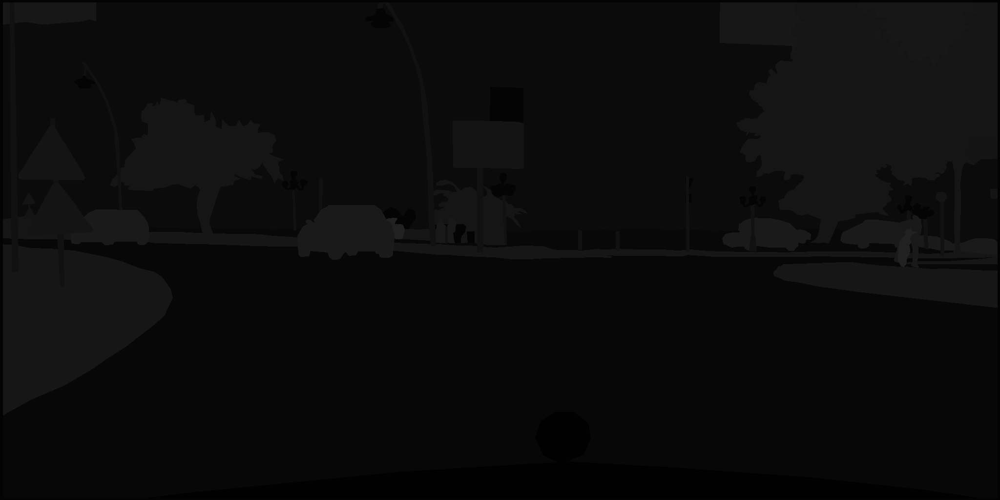

In [0]:
img=cv2.imread('/content/drive/My Drive/Colab Notebooks/L15/cityscapes_dataset/gtFine/train/aachen/aachen_000000_000019_gtFine_labelIds.png')
uni=np.unique(img.reshape((-1,3)),axis=0)
print(uni)
Image('/content/drive/My Drive/Colab Notebooks/L15/cityscapes_dataset/gtFine/train/aachen/aachen_000000_000019_gtFine_labelIds.png')

## 2.1. Nhãn dữ liệu
Chi tiết:
 - name: tên class
 - id: id mặc định gán cho mỗi class. Các id này được thể hiện trong các nhãn gtFine_labelIds.png
 - trainId: phụ thuộc vào cách tiếp cận, ta có thể tùy ý gán nhãn để sau khi training, mô hình đạt kết quả tốt. Thông thường, số nhãn quá nhiều, mô hình học khó hơn và, có thể không đủ dữ liệu. Số nhãn quá ít làm lẫn lộn đặc trưng các class, có thể đem lại kết quả xấu.   
 
**Trong bài toán này, ta thử sử dụng trainId mặc định, sửa đổi một chút để thuận tiện cho việc tạo one-hot vector sau này: các trainId mặc định là 255 sửa thành 19.**

In [0]:
!python -m cityscapesscripts.helpers.labels

List of cityscapes labels:

                     name |  id | trainId |       category | categoryId | hasInstances | ignoreInEval
    --------------------------------------------------------------------------------------------------
                unlabeled |   0 |      19 |           void |          0 |            0 |            1
              ego vehicle |   1 |      19 |           void |          0 |            0 |            1
     rectification border |   2 |      19 |           void |          0 |            0 |            1
               out of roi |   3 |      19 |           void |          0 |            0 |            1
                   static |   4 |      19 |           void |          0 |            0 |            1
                  dynamic |   5 |      19 |           void |          0 |            0 |            1
                   ground |   6 |      19 |           void |          0 |            0 |            1
                     road |   7 |       0 |          

Setup biến môi trường, phục vụ cho các scipts để chuẩn bị dữ liệu và đánh giá mô hình (kèm theo trong github của cityscapes)

In [0]:
os.environ['CITYSCAPES_DATASET']='/content/drive/My Drive/Colab Notebooks/L15/cityscapes_dataset'

In [0]:
!echo $CITYSCAPES_DATASET

/content/drive/My Drive/Colab Notebooks/L15/cityscapes_dataset


## Sinh nhãn dữ liệu  
Sử dụng scipt được cung cấp sẵn, tạo các nhãn dữ liệu là các ảnh *gtFine_labelTrainIds.png, mỗi pixel mang giá trị trainId ở trên (0-19). Các ảnh này là nhãn cho quá trình training với 20 classes.

In [0]:
!python -m cityscapesscripts.preparation.createTrainIdLabelImgs

Processing 5000 annotation files
Progress: 100.0 % 

Kiểm tra lại  ảnh nhãn được sinh ra

[[ 0  0  0]
 [ 1  1  1]
 [ 2  2  2]
 [ 5  5  5]
 [ 7  7  7]
 [ 8  8  8]
 [ 9  9  9]
 [10 10 10]
 [11 11 11]
 [12 12 12]
 [13 13 13]
 [18 18 18]
 [19 19 19]]


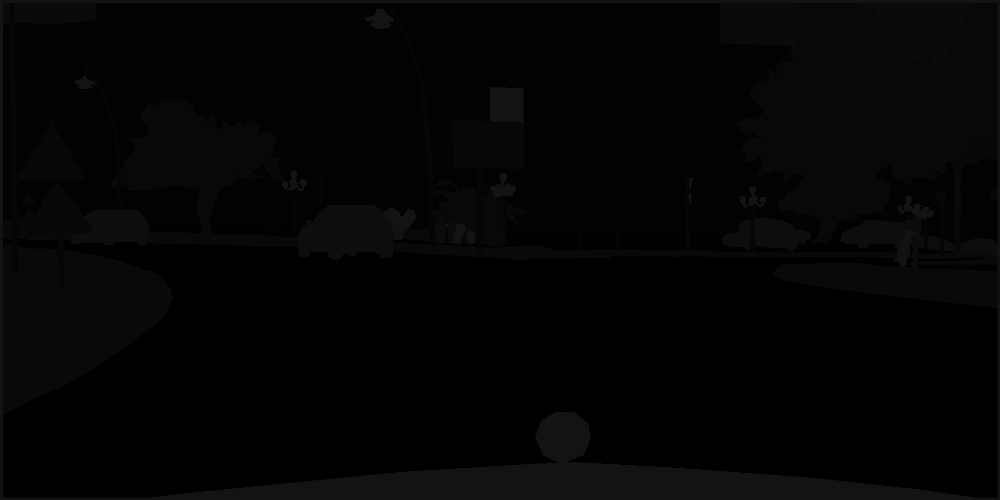

In [0]:
img=cv2.imread('/content/drive/My Drive/Colab Notebooks/L15/cityscapes_dataset/gtFine/train/aachen/aachen_000000_000019_gtFine_labelTrainIds.png')
uni=np.unique(img.reshape((-1,3)),axis=0)
print(uni)
Image('/content/drive/My Drive/Colab Notebooks/L15/cityscapes_dataset/gtFine/train/aachen/aachen_000000_000019_gtFine_labelTrainIds.png')

# 3.Model building

Chuẩn bị các tham số cho quá trinh training

In [0]:
DATA_DIRECTORY = './data'
VGG_PATH = './data/vgg'

In [0]:
NUMBER_OF_CLASSES = 20
IMAGE_SHAPE = (1024, 2048)

EPOCHS = 4
BATCH_SIZE = 2

LEARNING_RATE = 0.0001
DROPOUT = 0.75

In [0]:
correct_label = tf.placeholder(tf.float32, [None, IMAGE_SHAPE[0], IMAGE_SHAPE[1], NUMBER_OF_CLASSES])
learning_rate = tf.placeholder(tf.float32)
keep_prob = tf.placeholder(tf.float32)

In [0]:
# Used for plotting to visualize if our training is going well given parameters
all_training_losses = [] 

## 3.1.Define model

### 3.1.1. Helper, wrapper functions

In [0]:
def maybe_download_pretrained_vgg(data_dir):
    """
    Download and extract pretrained vgg model if it doesn't exist
    :param data_dir: Directory to download the model to
    """
    vgg_filename = 'vgg.zip'
    vgg_path = os.path.join(data_dir, 'vgg')
    vgg_files = [
        os.path.join(vgg_path, 'variables/variables.data-00000-of-00001'),
        os.path.join(vgg_path, 'variables/variables.index'),
        os.path.join(vgg_path, 'saved_model.pb')]

    missing_vgg_files = [vgg_file for vgg_file in vgg_files if not os.path.exists(vgg_file)]
    if missing_vgg_files:
        # Clean vgg dir
        if os.path.exists(vgg_path):
            shutil.rmtree(vgg_path)
        os.makedirs(vgg_path)

        # Download vgg
        print('Downloading pre-trained vgg model...')
        with DLProgress(unit='B', unit_scale=True, miniters=1) as pbar:
            urlretrieve(
                'https://s3-us-west-1.amazonaws.com/udacity-selfdrivingcar/vgg.zip',
                os.path.join(vgg_path, vgg_filename),
                pbar.hook)

        # Extract vgg
        print('Extracting model...')
        zip_ref = zipfile.ZipFile(os.path.join(vgg_path, vgg_filename), 'r')
        zip_ref.extractall(data_dir)
        zip_ref.close()

        # Remove zip file to save space
        os.remove(os.path.join(vgg_path, vgg_filename))

In [0]:
def load_vgg(sess, vgg_path):
  """
  Load Pretrained VGG Model into TensorFlow.
  sess: TensorFlow Session
  vgg_path: Path to vgg folder, containing "variables/" and "saved_model.pb"
  return: Tuple of Tensors from VGG model (image_input, keep_prob, layer3, layer4, layer7)
  """
  # load the model and weights
  model = tf.saved_model.loader.load(sess, ['vgg16'], vgg_path)

  # Get Tensors to be returned from graph
  graph = tf.get_default_graph()
  
  image_input = graph.get_tensor_by_name('image_input:0')
  keep_prob = graph.get_tensor_by_name('keep_prob:0')
  layer3 = graph.get_tensor_by_name('layer3_out:0')
  layer4 = graph.get_tensor_by_name('layer4_out:0')
  layer7 = graph.get_tensor_by_name('layer7_out:0')

  return image_input, keep_prob, layer3, layer4, layer7

In [0]:
def conv_1x1(layer, layer_name):
  """ Return the output of a 1x1 convolution of a layer """
  return tf.layers.conv2d(inputs = layer,
                          filters =  NUMBER_OF_CLASSES,
                          kernel_size = (1, 1),
                          strides = (1, 1),
                          name = layer_name)

In [0]:
def upsample(layer, k, s, layer_name):
  """ Return the output of transpose convolution given kernel_size k and strides s """
  # See: http://deeplearning.net/software/theano/tutorial/conv_arithmetic.html#transposed-convolution-arithmetic
  return tf.layers.conv2d_transpose(inputs = layer,
                                    filters = NUMBER_OF_CLASSES,
                                    kernel_size = (k, k),
                                    strides = (s, s),
                                    padding = 'same',
                                    name = layer_name)

### 3.1.2. FCN8 define

In [0]:
def layers(vgg_layer3_out, vgg_layer4_out, vgg_layer7_out, num_classes = NUMBER_OF_CLASSES):
  """
  Create the layers for a fully convolutional network.  Build skip-layers using the vgg layers.
  vgg_layerX_out: TF Tensor for VGG Layer X output
  num_classes: Number of classes to classify
  return: The Tensor for the last layer of output
  """

  # Use a shorter variable name for simplicity
  layer3, layer4, layer7 = vgg_layer3_out, vgg_layer4_out, vgg_layer7_out

  # Apply a 1x1 convolution to encoder layers
  layer3x = conv_1x1(layer = layer3, layer_name = "layer3conv1x1")
  layer4x = conv_1x1(layer = layer4, layer_name = "layer4conv1x1")
  layer7x = conv_1x1(layer = layer7, layer_name = "layer7conv1x1")
 
  # Add decoder layers to the network with skip connections and upsampling
  decoderlayer1 = upsample(layer = layer7x, k = 4, s = 2, layer_name = "decoderlayer1")
  decoderlayer2 = tf.add(decoderlayer1, layer4x, name = "decoderlayer2")
  decoderlayer3 = upsample(layer = decoderlayer2, k = 4, s = 2, layer_name = "decoderlayer3")
  decoderlayer4 = tf.add(decoderlayer3, layer3x, name = "decoderlayer4")
  decoderlayer_output = upsample(layer = decoderlayer4, k = 16, s = 8, layer_name = "decoderlayer_output")

  return decoderlayer_output

In [0]:
def layers_verbose(vgg_layer3_out, vgg_layer4_out, vgg_layer7_out, num_classes = NUMBER_OF_CLASSES):

  # Use a shorter variable name for simplicity
  layer3, layer4, layer7 = vgg_layer3_out, vgg_layer4_out, vgg_layer7_out

  # Apply a 1x1 convolution to encoder layers
  layer3x = conv_1x1(layer = layer3, layer_name = "layer3conv1x1")
  layer4x = conv_1x1(layer = layer4, layer_name = "layer4conv1x1")
  layer7x = conv_1x1(layer = layer7, layer_name = "layer7conv1x1")
 
  decoderlayer1 = upsample(layer = layer7x, k = 4, s = 2, layer_name = "decoderlayer1")
  decoderlayer2 = tf.add(decoderlayer1, layer4x, name = "decoderlayer2")
  decoderlayer3 = upsample(layer = decoderlayer2, k = 4, s = 2, layer_name = "decoderlayer3")
  decoderlayer4 = tf.add(decoderlayer3, layer3x, name = "decoderlayer4")
  decoderlayer_output = upsample(layer = decoderlayer4, k = 16, s = 8, layer_name = "decoderlayer_output")

  return layer3, layer4, layer7, layer3x, layer4x, layer7x, \
         decoderlayer1, decoderlayer2, decoderlayer3, decoderlayer4, decoderlayer_output

In [0]:
def optimize(nn_last_layer, correct_label, learning_rate, num_classes = NUMBER_OF_CLASSES):
  """
  Build the TensorFLow loss and optimizer operations.
  nn_last_layer: TF Tensor of the last layer in the neural network
  correct_label: TF Placeholder for the correct label image
  learning_rate: TF Placeholder for the learning rate
  num_classes: Number of classes to classify
  return: Tuple of (logits, train_op, cross_entropy_loss)
  """
  outputs=tf.math.argmax(nn_last_layer,axis=-1,name='outputs')

  # The cross_entropy_loss is the cost which we are trying to minimize to yield higher accuracy
  cross_entropy = tf.nn.softmax_cross_entropy_with_logits(logits = nn_last_layer, labels = correct_label)
  cross_entropy_loss = tf.reduce_mean(cross_entropy)

  # The model implements this operation to find the weights/parameters that would yield correct pixel labels
  train_op = tf.train.AdamOptimizer(learning_rate).minimize(cross_entropy_loss)

  return outputs, train_op, cross_entropy_loss


In [0]:
def train_nn(sess, epochs, batch_size, gen_batches, train_op,
             cross_entropy_loss, input_image,
             correct_label, keep_prob, learning_rate):
  """
  Train neural network and print out the loss during training.
  sess: TF Session
  epochs: Number of epochs
  batch_size: Batch size
  get_batches_fn: Function to get batches of training data.  Call using get_batches_fn(batch_size)
  train_op: TF Operation to train the neural network
  cross_entropy_loss: TF Tensor for the amount of loss
  input_image: TF Placeholder for input images
  correct_label: TF Placeholder for label images
  keep_prob: TF Placeholder for dropout keep probability
  learning_rate: TF Placeholder for learning rate
  """

  for epoch in range(epochs):
    losses, i = [], 0
    
    for images, labels in gen_batches(batch_size=BATCH_SIZE):
        
      i += 1
    
      feed = { input_image: images,
               correct_label: labels,
               keep_prob: DROPOUT,
               learning_rate: LEARNING_RATE }
        
      _, partial_loss = sess.run([train_op, cross_entropy_loss], feed_dict = feed)
      
      print("---> iteration: ", i, " partial loss:", partial_loss)
      losses.append(partial_loss)
          
    training_loss = sum(losses) / len(losses)
    all_training_losses.append(training_loss)
    
    print("------------------")
    print("epoch: ", epoch + 1, " of ", EPOCHS, "training loss: ", training_loss)
    print("------------------")
    

## 3.2. Batches generator và one-hot encoder

In [0]:
def get_label_path(img_path):
  basename=os.path.basename(img_path)
  dirname=os.path.dirname(img_path)
  return os.path.join(dirname.replace('leftImg8bit','gtFine'),basename.replace('leftImg8bit','gtFine_labelTrainIds'))

In [0]:
from glob import glob
# all pairs of train image and label
pair_paths = [(img_path,get_label_path(img_path)) for img_path in glob(os.path.join('cityscapes_dataset','leftImg8bit','train', '*', '*.png'))]
NUMBER_OF_IMAGES=len(pair_paths)
print(pair_paths[:5])

[('cityscapes_dataset/leftImg8bit/train/stuttgart/stuttgart_000003_000019_leftImg8bit.png', 'cityscapes_dataset/gtFine/train/stuttgart/stuttgart_000003_000019_gtFine_labelTrainIds.png'), ('cityscapes_dataset/leftImg8bit/train/stuttgart/stuttgart_000000_000019_leftImg8bit.png', 'cityscapes_dataset/gtFine/train/stuttgart/stuttgart_000000_000019_gtFine_labelTrainIds.png'), ('cityscapes_dataset/leftImg8bit/train/stuttgart/stuttgart_000002_000019_leftImg8bit.png', 'cityscapes_dataset/gtFine/train/stuttgart/stuttgart_000002_000019_gtFine_labelTrainIds.png'), ('cityscapes_dataset/leftImg8bit/train/stuttgart/stuttgart_000004_000019_leftImg8bit.png', 'cityscapes_dataset/gtFine/train/stuttgart/stuttgart_000004_000019_gtFine_labelTrainIds.png'), ('cityscapes_dataset/leftImg8bit/train/stuttgart/stuttgart_000001_000019_leftImg8bit.png', 'cityscapes_dataset/gtFine/train/stuttgart/stuttgart_000001_000019_gtFine_labelTrainIds.png')]


One-hot encode function

In [0]:
def onehot_encode(a,num_classes=20):
    out = np.zeros( (a.size,num_classes), dtype=np.uint8)
    out[np.arange(a.size),a.ravel()] = 1
    out.shape = a.shape + (num_classes,)
    return out

In [0]:
onehot_encode(np.array([[1,2],[2,4]]))

array([[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]],

       [[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]],
      dtype=uint8)

In [0]:
import random

def gen_batches(batch_size=BATCH_SIZE):
  """
  Create batches of training data
  :param batch_size: Batch Size
  :return: Batches of training data
  """
  random.shuffle(pair_paths)
  for batch_i in range(0, len(pair_paths), batch_size):
      images = []
      gt_images = []
      for pair in pair_paths[batch_i:batch_i+batch_size]:
          image = cv2.imread(pair[0])
          gt_image = cv2.imread(pair[1])[:,:,0]
          gt_one_hot=onehot_encode(gt_image,num_classes=NUMBER_OF_CLASSES)
          
          images.append(image)
          gt_images.append(gt_one_hot)

      yield np.array(images), np.array(gt_images)

In [0]:
_,gt=next(gen_batches(1))
print(gt.shape)
uni=np.unique(gt.reshape((-1,20)),axis=0)
print(uni)
print(gt)

(1, 1024, 2048, 20)
[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]
[[[[0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   ...
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]]

  [[0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   ...
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]]

  [[0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   ...
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]]

  ...

  [[0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   ...
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]
   [0 0 0 ... 0 0 1]]

  

In [0]:
import sys
sys.path.append('./cityscapesscripts/helpers')
import labels

Hàm convert ảnh trong đó mỗ pixel là TrainIds (0-19) sang ảnh mới, trong đó mỗi pixel được gán nhãn theo Id chuẩn (0-33), dùng đánh giá mô hình

In [0]:
def img_trainId2Id(img):
  out=np.zeros((img.shape[0],img.shape[1]))
  for i in range(img.shape[0]):
    for j in range(img.shape[1]):
      out[i,j]=labels.trainId2Id[img[i,j]]
  return out

In [0]:
def gen_output(sess, outputs, keep_prob, image_pl, input_folder,output_folder, image_shape):
    """
    Generate test output using the test images
    :param sess: TF session
    :param logits: TF Tensor for the logits
    :param keep_prob: TF Placeholder for the dropout keep robability
    :param image_pl: TF Placeholder for the image placeholder
    :param data_folder: Path to the folder that contains the datasets
    :param image_shape: Tuple - Shape of image
    :return: Output for for each test image
    """
    print(os.path.join(input_folder, '*.png'))
    for image_file in glob(os.path.join(input_folder, '*.png')):
        image=cv2.imread(image_file)

        im_softmax = sess.run(
            outputs,
            {keep_prob: 1.0, image_pl: [image]})[0]
        
        
        out=img_trainId2Id(im_softmax)
        out_path=get_label_path(image_file)
        print(out_path)
        cv2.imwrite(out_path,out)

# 4.Training 

In [0]:
TEST_INPUT_FOLDER=os.path.join('simple_test','leftImg8bit')
TEST_OUTPUT_FOLDER=os.path.join('simple_test','gtFine')
def run():
  print("NUMBER OF IMAGES:", NUMBER_OF_IMAGES)

  # download vgg model
  maybe_download_pretrained_vgg(DATA_DIRECTORY)
  
  export_dir = './cityscapes_exported_model'
  if not os.path.isdir(export_dir):
    os.mkdir(export_dir)
  
  with tf.Session() as session:
        
    # Returns the three layers, keep probability and input layer from the vgg architecture
    image_input, keep_prob, layer3, layer4, layer7 = load_vgg(session, VGG_PATH)

    # The resulting network architecture, adding a decoder on top of the given vgg model
    model_output = layers(layer3, layer4, layer7, NUMBER_OF_CLASSES)

    # Returns the output logits, training operation and cost operation to be used
    # For the logits: each row represents a pixel, each column a class
    # training operation is what is used to get the right parameters to the model to correctly label the pixels
    # the cross entropy loss is the cost which we are minimizing, lower cost should yield higher accuracy
    outputs, train_op, cross_entropy_loss = optimize(model_output, correct_label, learning_rate, NUMBER_OF_CLASSES)
    
    # Initilize all variables
    session.run([tf.global_variables_initializer(), tf.local_variables_initializer()])

    # train the neural network
    train_nn(session, EPOCHS, BATCH_SIZE, gen_batches, 
             train_op, cross_entropy_loss, image_input,
             correct_label, keep_prob, learning_rate)
    
    # Save inference data
#     helper.save_inference_samples(RUNS_DIRECTORY, DATA_DIRECTORY, session, IMAGE_SHAPE, logits, keep_prob, image_input)
    print("Generating output label images...")
    gen_output(session,outputs,keep_prob,image_input, TEST_INPUT_FOLDER,TEST_OUTPUT_FOLDER, IMAGE_SHAPE)
    tf.saved_model.simple_save(session, export_dir, 
                               inputs={"keep_prob:0": keep_prob, "image_input:0": image_input}, 
                               outputs={"outputs:0":outputs})

In [0]:
# Train the network
run()

NUMBER OF IMAGES: 2975


W0713 17:35:11.861676 140040624256896 deprecation.py:323] From <ipython-input-21-fbdedb9a877d>:9: load (from tensorflow.python.saved_model.loader_impl) is deprecated and will be removed in a future version.
Instructions for updating:
This function will only be available through the v1 compatibility library as tf.compat.v1.saved_model.loader.load or tf.compat.v1.saved_model.load. There will be a new function for importing SavedModels in Tensorflow 2.0.
W0713 17:35:20.356279 140040624256896 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.
W0713 17:35:29.709924 140040624256896 deprecation.py:323] From <ipython-input-22-479e0abd1c41>:7: conv2d (from tensorflow.python.layers.convolutional) is deprecated and will be removed

---> iteration:  1  partial loss: 71.97882
---> iteration:  2  partial loss: 62.059055
---> iteration:  3  partial loss: 47.131092
---> iteration:  4  partial loss: 38.820156
---> iteration:  5  partial loss: 29.12718
---> iteration:  6  partial loss: 24.59268
---> iteration:  7  partial loss: 19.253185
---> iteration:  8  partial loss: 15.903174
---> iteration:  9  partial loss: 18.601858
---> iteration:  10  partial loss: 11.577763
---> iteration:  11  partial loss: 10.7060795
---> iteration:  12  partial loss: 10.466988
---> iteration:  13  partial loss: 8.531073
---> iteration:  14  partial loss: 8.662242
---> iteration:  15  partial loss: 6.543383
---> iteration:  16  partial loss: 5.8121014
---> iteration:  17  partial loss: 6.0993366
---> iteration:  18  partial loss: 5.8257236
---> iteration:  19  partial loss: 4.713888
---> iteration:  20  partial loss: 4.916752
---> iteration:  21  partial loss: 4.429746
---> iteration:  22  partial loss: 3.788907
---> iteration:  23  partial

W0714 03:34:18.589056 140040624256896 deprecation.py:323] From <ipython-input-38-f865f8088e7a>:41: simple_save (from tensorflow.python.saved_model.simple_save) is deprecated and will be removed in a future version.
Instructions for updating:
This function will only be available through the v1 compatibility library as tf.compat.v1.saved_model.simple_save.
W0714 03:34:18.590616 140040624256896 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/saved_model/signature_def_utils_impl.py:201: build_tensor_info (from tensorflow.python.saved_model.utils_impl) is deprecated and will be removed in a future version.
Instructions for updating:
This function will only be available through the v1 compatibility library as tf.compat.v1.saved_model.utils.build_tensor_info or tf.compat.v1.saved_model.build_tensor_info.


# 5.Output và đánh giá mô hình

In [0]:
!ls ./cityscapes_exported_model

saved_model.pb	variables


In [0]:
export_dir = './cityscapes_exported_model'
graph=tf.Graph()
sess=tf.Session(graph=graph)
tf.saved_model.loader.load(sess, ["serve"], export_dir)
graph2=tf.get_default_graph()   

W0716 18:48:17.249683 139971683616640 deprecation.py:323] From <ipython-input-10-02a516dae11f>:4: load (from tensorflow.python.saved_model.loader_impl) is deprecated and will be removed in a future version.
Instructions for updating:
This function will only be available through the v1 compatibility library as tf.compat.v1.saved_model.loader.load or tf.compat.v1.saved_model.load. There will be a new function for importing SavedModels in Tensorflow 2.0.
W0716 18:48:25.047708 139971683616640 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.


## 5.1. Visualize graph

In [0]:
from IPython.display import clear_output, Image, display, HTML

# Helper functions for TF Graph visualization

def strip_consts(graph_def, max_const_size=32):
    """Strip large constant values from graph_def."""
    strip_def = tf.GraphDef()
    for n0 in graph_def.node:
        n = strip_def.node.add() 
        n.MergeFrom(n0)
        if n.op == 'Const':
            tensor = n.attr['value'].tensor
            size = len(tensor.tensor_content)
            if size > max_const_size:
                tensor.tensor_content = tf.compat.as_bytes("<stripped %d bytes>"%size)
    return strip_def
  
def rename_nodes(graph_def, rename_func):
    res_def = tf.GraphDef()
    for n0 in graph_def.node:
        n = res_def.node.add() 
        n.MergeFrom(n0)
        n.name = rename_func(n.name)
        for i, s in enumerate(n.input):
            n.input[i] = rename_func(s) if s[0]!='^' else '^'+rename_func(s[1:])
    return res_def
  
def show_graph(graph_def, max_const_size=32):
    """Visualize TensorFlow graph."""
    if hasattr(graph_def, 'as_graph_def'):
        graph_def = graph_def.as_graph_def()
    strip_def = strip_consts(graph_def, max_const_size=max_const_size)
    code = """
        <script>
          function load() {{
            document.getElementById("{id}").pbtxt = {data};
          }}
        </script>
        <link rel="import" href="https://tensorboard.appspot.com/tf-graph-basic.build.html" onload=load()>
        <div style="height:600px">
          <tf-graph-basic id="{id}"></tf-graph-basic>
        </div>
    """.format(data=repr(str(strip_def)), id='graph'+str(np.random.rand()))
  
    iframe = """
        <iframe seamless style="width:1600px;height:1240px;border:0" srcdoc="{}"></iframe>
    """.format(code.replace('"', '&quot;'))
    display(HTML(iframe))

In [0]:
show_graph(graph)

## 5.2. Sinh output trên tập validation

Sinh ra output cho các ảnh trong tập validation (500 ảnh) , dùng đánh giá mô hình.  
Outputs được lưu dưới dạng các ảnh, mỗi pixel là regular ID (0-33), có thể sử dụng để đánh giá mô hình bằng scripts được cung cấp bởi cityscape team.

In [0]:
num=len(glob(os.path.join('cityscapes_dataset','leftImg8bit','val','*', '*.png')))
for i,image_file in enumerate(glob(os.path.join('cityscapes_dataset','leftImg8bit','val','*', '*.png'))):
    image=cv2.imread(image_file)

    im_softmax = sess.run(
        'outputs:0',
        {"keep_prob:0": 1.0, "image_input:0": [image]})[0]


    out=img_trainId2Id(im_softmax)
    out_path=os.path.join('cityscapes_dataset','results',os.path.basename(image_file))
    print('%d/%d'%(i+1,num),out_path)
    cv2.imwrite(out_path,out)

1/500 cityscapes_dataset/results/frankfurt_000001_066574_leftImg8bit.png
2/500 cityscapes_dataset/results/frankfurt_000001_067474_leftImg8bit.png
3/500 cityscapes_dataset/results/frankfurt_000001_077092_leftImg8bit.png
4/500 cityscapes_dataset/results/frankfurt_000001_028590_leftImg8bit.png
5/500 cityscapes_dataset/results/frankfurt_000001_003056_leftImg8bit.png
6/500 cityscapes_dataset/results/frankfurt_000001_028335_leftImg8bit.png
7/500 cityscapes_dataset/results/frankfurt_000001_050149_leftImg8bit.png
8/500 cityscapes_dataset/results/frankfurt_000001_043395_leftImg8bit.png
9/500 cityscapes_dataset/results/frankfurt_000001_059119_leftImg8bit.png
10/500 cityscapes_dataset/results/frankfurt_000000_005543_leftImg8bit.png
11/500 cityscapes_dataset/results/frankfurt_000001_010156_leftImg8bit.png
12/500 cityscapes_dataset/results/frankfurt_000001_064130_leftImg8bit.png
13/500 cityscapes_dataset/results/frankfurt_000000_001016_leftImg8bit.png
14/500 cityscapes_dataset/results/frankfurt_000

## 5.3. Đánh giá mô hình   
Sử dụng cript đánh giá kết quả mô hình được cung cấp.   
Mô hình được đánh giá dựa trên IoU trên từng class/category    
"To assess performance, we rely on the standard Jaccard Index, commonly known as the PASCAL VOC intersection-over-union metric IoU = TP ⁄ (TP+FP+FN) [1], where TP, FP, and FN are the numbers of true positive, false positive, and false negative pixels, respectively, determined over the whole test set. Owing to the two semantic granularities, i.e. classes and categories, we report two separate mean performance scores: IoUcategory and IoUclass. In either case, pixels labeled as void do not contribute to the score"  
Chi tiết thêm tại:
https://www.cityscapes-dataset.com/benchmarks/

In [0]:
!python -m cityscapesscripts.evaluation.evalPixelLevelSemanticLabeling

Evaluating 500 pairs of images...
Images Processed: 500 

--------------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------- 
              |   u   |   e   |   r   |   o   |   s   |   d   |   g   |   r   |   s   |   p   |   r   |   b   |   w   |   f   |   g   |   b   |   t   |   p   |   p   |   t   |   t   |   v   |   t   |   s   |   p   |   r   |   c   |   t   |   b   |   c   |   t   |   t   |   m   |   b   |  Prior |
--------------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------  ------

# 6.Visualize kết quả

Visualize output của mô hình trên các tập train, val, test.  
Trên tập val và test, mỗi thành phố chọn một ảnh đại diện để visualize kết quả.

In [0]:
import PIL
import imageio

def trainId2Mask(img):
  out=np.zeros((img.shape[0],img.shape[1],4),dtype=np.uint8)
  for i in range(img.shape[0]):
    for j in range(img.shape[1]):
      out[i,j]=labels.trainId2Mask[img[i,j]]
  return PIL.Image.fromarray(out,mode='RGBA')

In [0]:
mkdir visualize_fcn

In [0]:
def visualize(sess,img_path):
  """
  Function to visualize model's output
  """
  img=cv2.imread(img_path)
  img_label=sess.run(
        'outputs:0',
        {"keep_prob:0": 1.0, "image_input:0": [img]})[0]
  
  img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  mask=trainId2Mask(img_label)
  img=PIL.Image.fromarray(img,mode='RGB')
  img.paste(mask,box=None,mask=mask)
  out_path=os.path.join('visualize_fcn',os.path.basename(img_path))
  img.save(out_path)
  i=Image(out_path)
  display(i)

## 6.1. Với ảnh train

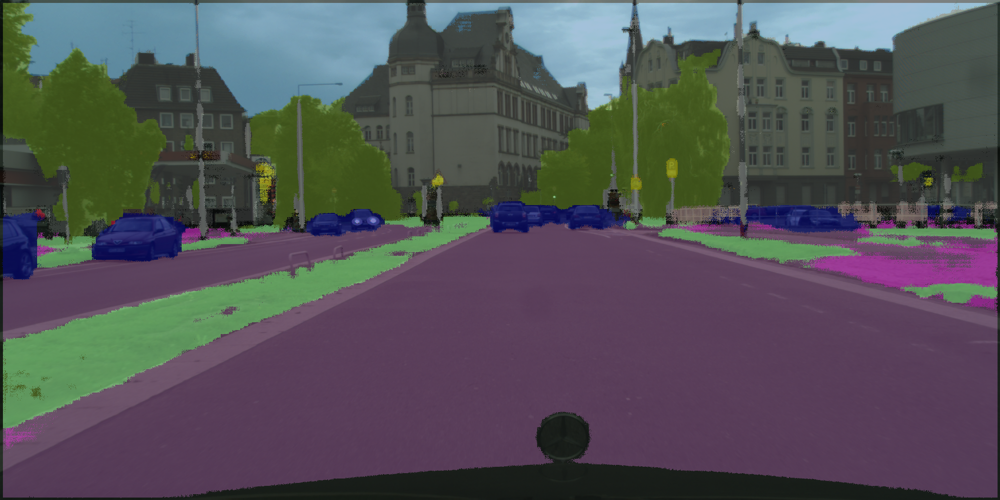

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/train/aachen/aachen_000001_000019_leftImg8bit.png')

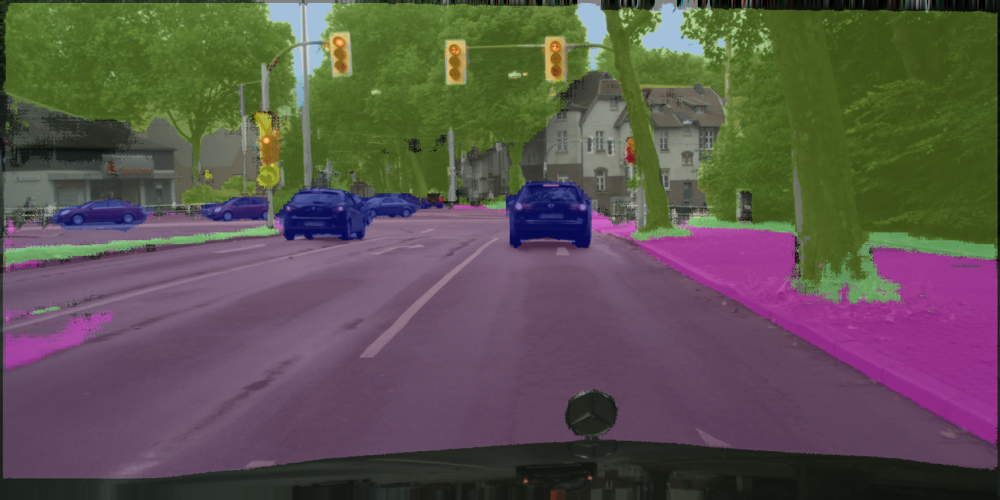

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/train/bochum/bochum_000000_000600_leftImg8bit.png')

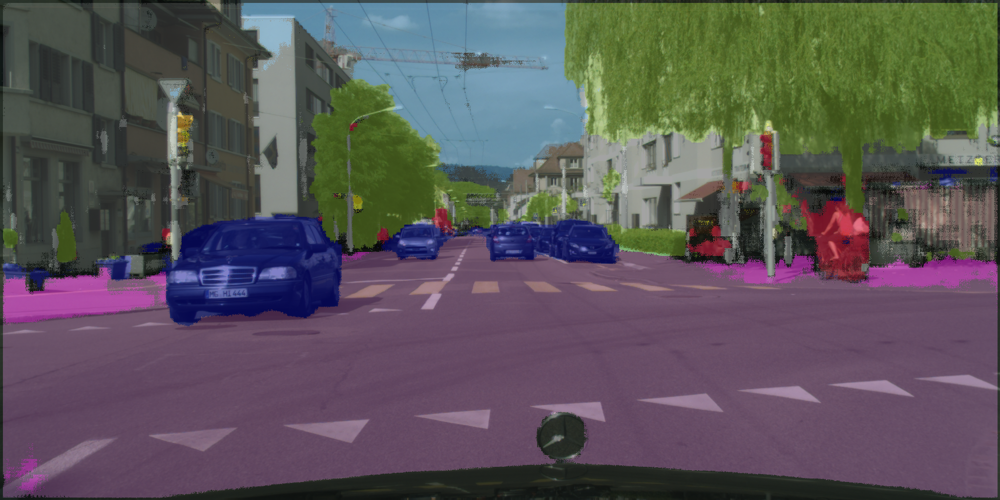

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/train/zurich/zurich_000121_000019_leftImg8bit.png')

## 6.2. Với ảnh val

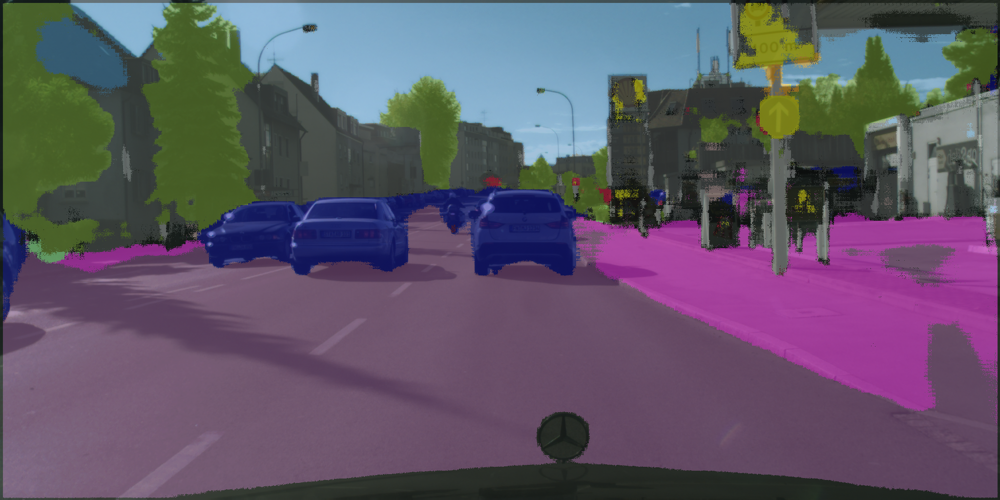

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/val/lindau/lindau_000057_000019_leftImg8bit.png')

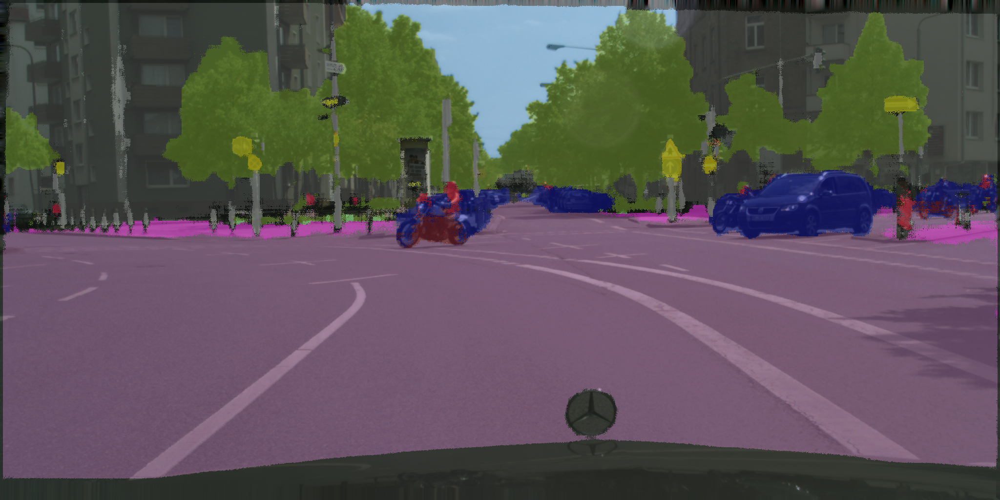

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/val/frankfurt/frankfurt_000001_083199_leftImg8bit.png')

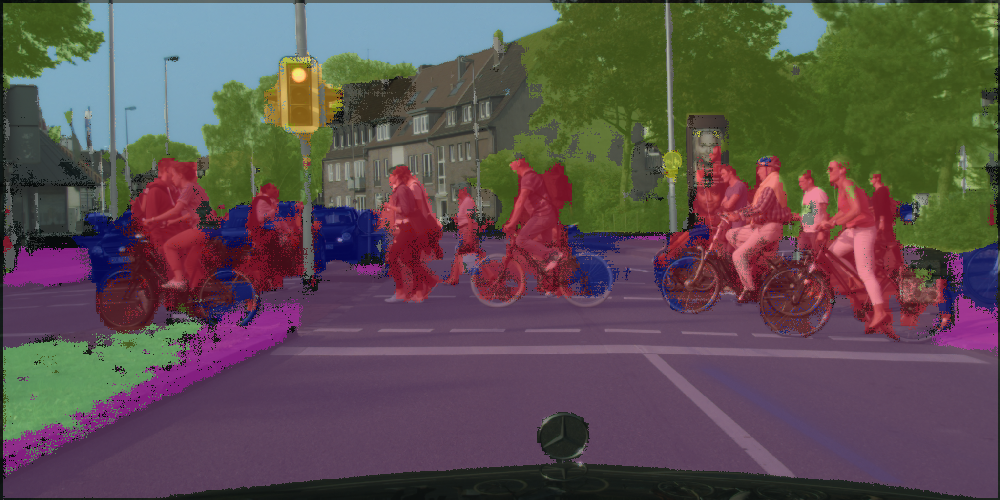

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/val/munster/munster_000167_000019_leftImg8bit.png')

## 6.3. Với ảnh test

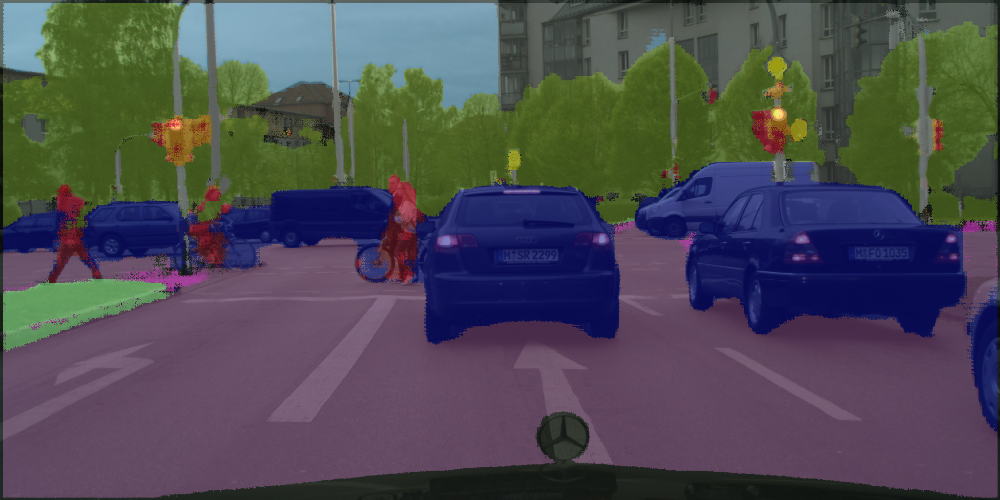

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/test/munich/munich_000389_000019_leftImg8bit.png')

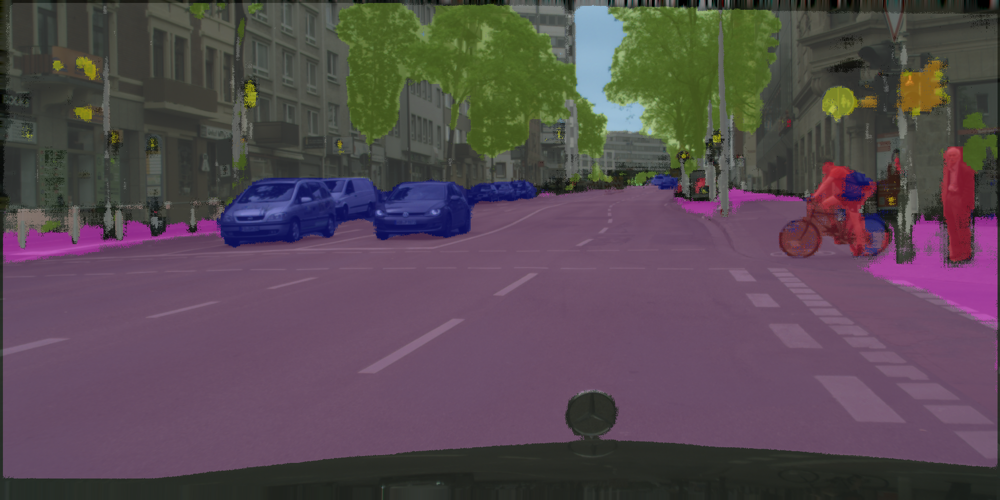

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/test/mainz/mainz_000003_005162_leftImg8bit.png')

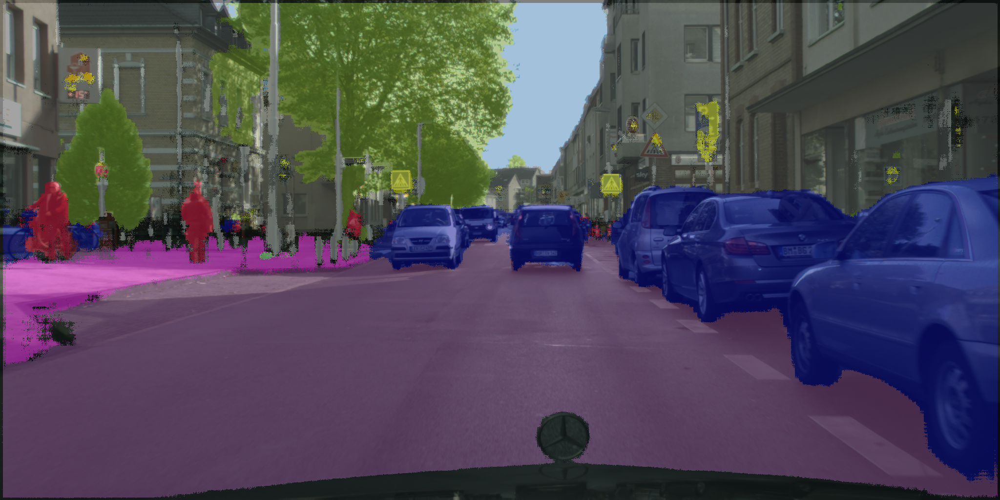

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/test/leverkusen/leverkusen_000036_000019_leftImg8bit.png')

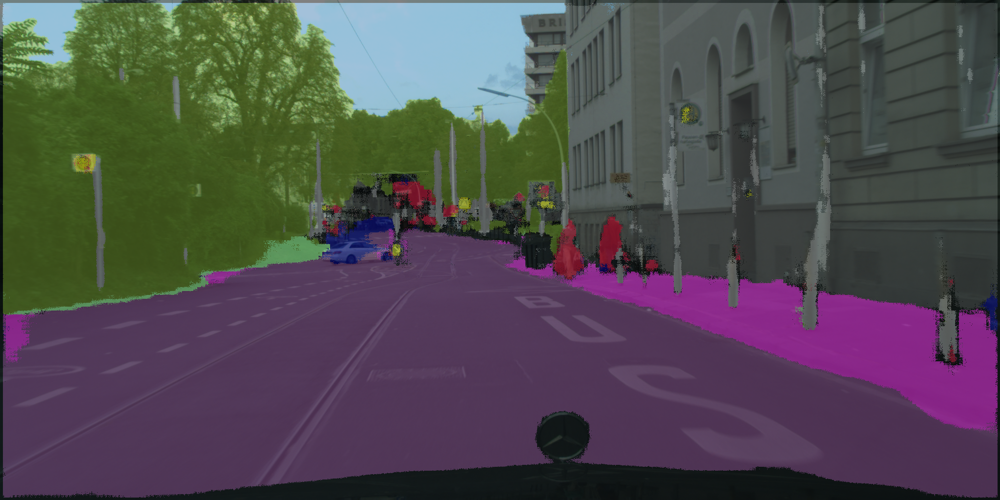

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/test/bonn/bonn_000043_000019_leftImg8bit.png')

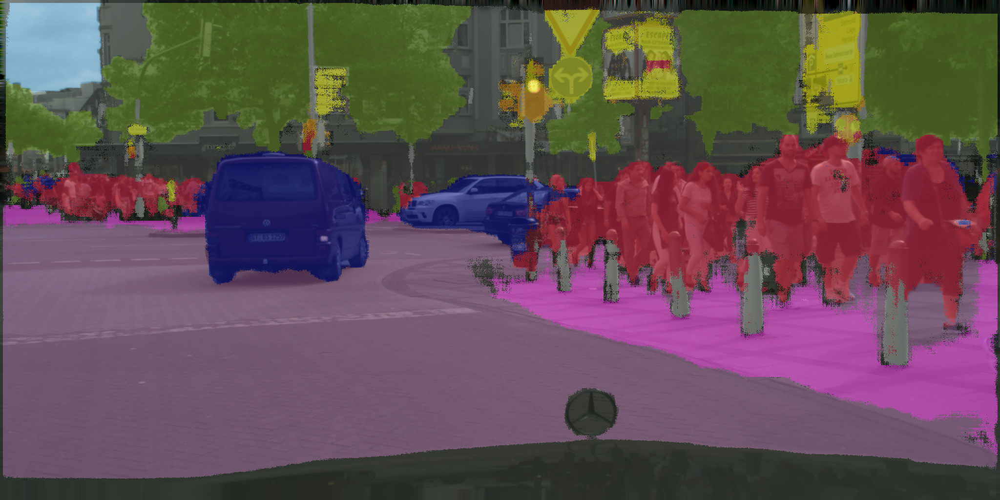

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/test/bielefeld/bielefeld_000000_059766_leftImg8bit.png')

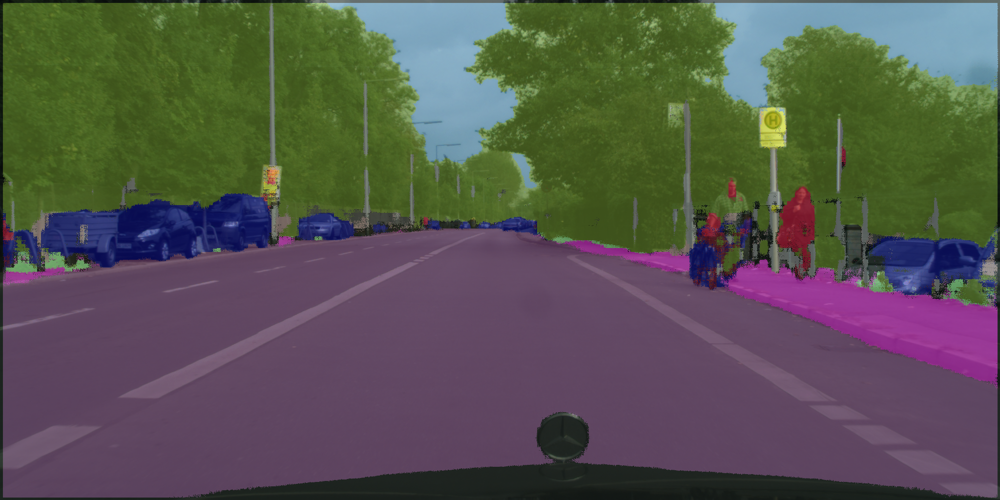

In [0]:
visualize(sess,'cityscapes_dataset/leftImg8bit/test/berlin/berlin_000543_000019_leftImg8bit.png')